In [7]:
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
from torch.autograd import Variable
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from torch.optim.lr_scheduler import StepLR
from torchvision.models import inception_v3
from scipy import stats
from scipy.stats import entropy
from PIL import Image


seed = random.randint(1, 10000) # random seed
print("Random Seed: ", seed)
random.seed(seed)
torch.manual_seed(seed)

Random Seed:  5957


In [8]:
# Root directory for dataset
dataroot = "~/datasets/anime-faces"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 64

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 15

# Starting Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

43102


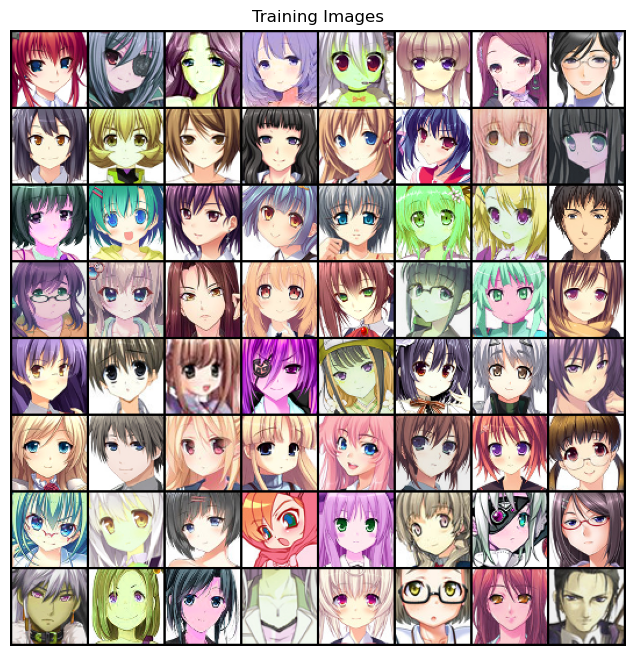

In [9]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
original_dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
augmented_dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               # adding some data augmentation
                               transforms.RandomHorizontalFlip(),
                               transforms.ColorJitter(contrast=0.2, saturation=0.2, hue=0.2),
                               #
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
dataset = torch.utils.data.ConcatDataset([original_dataset, augmented_dataset])
print(len(dataset))


# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=1,
                                         shuffle=True, num_workers=workers)

counter = 0
limit = 2048

for i, (image, _) in enumerate(dataloader):
    # In the DataLoader, each element is assumed to be (image, label)
    if counter < limit:
        vutils.save_image(image.cpu(), f"real_images/real_image_{i}.png")
        counter += 1
    else:
        break


# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [10]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [11]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.LeakyReLU(0.2),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.LeakyReLU(0.2),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.LeakyReLU(0.2),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.LeakyReLU(0.2),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

In [12]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.2)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding

In [13]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(3, 64, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(64, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(128, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(256, 512, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(512, 1, 4, 1, 0, bias=False),
            nn.Flatten()
        )
        

    def forward(self, input):
        return self.main(input)

In [14]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

#Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Flatten(start_dim=1, end_dim=-1)
  )
)


In [15]:

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

optimizerD = torch.optim.RMSprop(netD.parameters(), lr=lr)
optimizerG = torch.optim.RMSprop(netG.parameters(), lr=lr)

In [19]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

# labels
one = torch.FloatTensor([1]).to(device)
mone = one * -1
mone = mone.to(device)

# images for calculating inception score


print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        # resetting the gradients
        netD.zero_grad()
        optimizerD.zero_grad()

        # weight clipping
        for p in netD.parameters():
            p.data.clamp_(-0.01, 0.01)

        # getting real images
        real_images = data[0].to(device)
        # batch size
        b_size = real_images.size(0)
        # generating latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)

        # generating fake images
        fake_images = netG(noise)

        # pass through the real data
        real_predictions = netD(real_images).mean(0).view(1)
        real_predictions.backward(one)
        # pass through the fake images           
        fake_predictions = netD(fake_images).mean(0).view(1)
        fake_predictions.backward(mone)
            
        # calculating d_loss
        d_loss = fake_predictions - real_predictions
   
        optimizerD.step()    
        
        # training generator every 3 iterations
        if i % 3 == 0:
            netG.zero_grad()
            optimizerG.zero_grad()
            # training the generator
            # generating latent vectors
            noise = torch.randn(b_size, nz, 1, 1, device=device)
            # generating fake images
            fake_images = netG(noise)
            # pass through the fake images
            gen_fake_predictions = netD(fake_images)
            # calculating loss for the generator
            g_loss = gen_fake_predictions.mean().mean(0).view(1)
            g_loss.backward(one)
            optimizerG.step()
            
        if i % 100 == 0:
            mse = compute_mse(real_images, fake_images)
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tMSE: %.4f'
                % (epoch, num_epochs, i, len(dataloader),
                    d_loss.item(), g_loss.item(), mse))

        # Save Losses for plotting later
        G_losses.append(g_loss.item())
        D_losses.append(d_loss.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
        iters += 1
        

Starting Training Loop...


[0/15][0/674]	Loss_D: -0.0008	Loss_G: 0.0412	MSE: 0.4227
[0/15][100/674]	Loss_D: 0.6113	Loss_G: 0.4600	MSE: 0.4486
[0/15][200/674]	Loss_D: 1.1530	Loss_G: 0.5996	MSE: 0.4659
[0/15][300/674]	Loss_D: 0.8911	Loss_G: 0.5741	MSE: 0.4726
[0/15][400/674]	Loss_D: 1.0862	Loss_G: 0.6194	MSE: 0.5123
[0/15][500/674]	Loss_D: 0.5354	Loss_G: 0.5485	MSE: 0.5387
[0/15][600/674]	Loss_D: 1.0784	Loss_G: 0.4872	MSE: 0.5550
[1/15][0/674]	Loss_D: 1.0797	Loss_G: 0.5229	MSE: 0.5775
[1/15][100/674]	Loss_D: 0.9484	Loss_G: 0.6322	MSE: 0.5047
[1/15][200/674]	Loss_D: 0.6999	Loss_G: 0.4556	MSE: 0.5664
[1/15][300/674]	Loss_D: 0.8377	Loss_G: 0.5988	MSE: 0.5531
[1/15][400/674]	Loss_D: 0.9865	Loss_G: 0.6097	MSE: 0.5380
[1/15][500/674]	Loss_D: 0.7085	Loss_G: 0.3602	MSE: 0.5208
[1/15][600/674]	Loss_D: 0.9179	Loss_G: 0.6372	MSE: 0.5883
[2/15][0/674]	Loss_D: 0.6993	Loss_G: 0.0854	MSE: 0.5372
[2/15][100/674]	Loss_D: 0.8972	Loss_G: 0.6080	MSE: 0.5679
[2/15][200/674]	Loss_D: 1.0654	Loss_G: 0.5637	MSE: 0.5745
[2/15][300/674]	Los

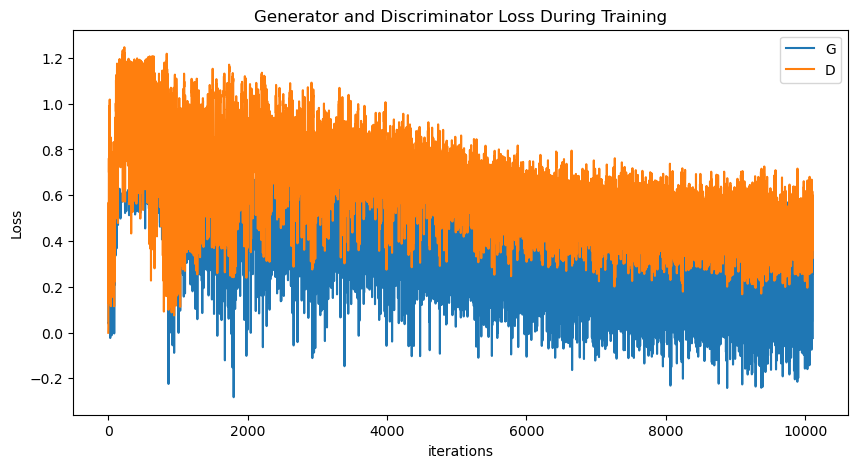

Inception score: 


/home/gr4ntes/miniconda3/envs/torch/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/gr4ntes/miniconda3/envs/torch/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


6.904710292816162


In [20]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()


print("Inception score: ")
noise = torch.randn(256, nz, 1, 1, device=device)
with torch.no_grad():
    fake_images = netG(noise).detach().cpu()
print(compute_inception_score(fake_images))

# generating images for computing the fid
noise = torch.randn(2048, nz, 1, 1, device=device)
with torch.no_grad():
    fake_images = netG(noise).detach().cpu()
for i in range(fake_images.shape[0]):
    # Here, images[i] is of shape [channels, height, width]
    vutils.save_image(fake_images[i].cpu(), f"fake_images/generated_image_{i}.png")




Animation size has reached 21699203 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


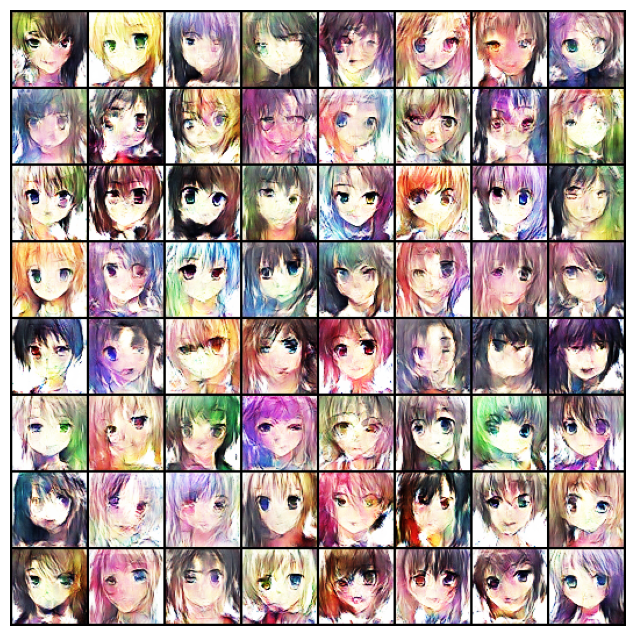

In [21]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())